In [1]:
from report import *
from matplotlib import pyplot as plt
import seaborn as sns
sns.set_style('white')
%matplotlib inline

"""
load model path/report table
"""
import os
import pandas as pd
import numpy as np
path='model/'
files = [f[:-4] for f in os.listdir(path) if f.endswith('.mps')]
files.sort()

total: 176474
residents: 160748
vacant: 15726
edges: 132489


In [2]:
"""
background data
"""
totalgdf = read_geo_file()
check = set(gdf.ID)
background = totalgdf[totalgdf.ID.apply(lambda var: var not in check)]

In [3]:
"""
plot function
"""

from Early_Model_Generator import real_dis_affect

def colorembed(var, max_):
    if var > max_*2.0/3:
        return 3
    if var > max_*1.0/3.0:
        return 2
    if var > 0:
        return 1
    return 0

def Area_plot(file_ ,iter_, budg , ax= None,radius = None, power = None, coltype = 1, modeltype = None,
              objtype = None):
    #print file_,iter_
    demolished = model_house_df[(model_house_df.model == file_) & (model_house_df.iter == iter_) & 
                                (model_house_df.budg == budg)].iloc[0,7:]

    tempgdf = gdf.copy()
    tempgdf["demolished"] = tempgdf.ID.apply(lambda var: demolished[var])

    if not radius:
        radius = int(file_.split("-")[1][1:])
        power = int(file_.split("-")[2][1:])
    
    
    tempogdf = ogdf.copy()
    tempogdf["improve"] = np.zeros(len(tempogdf))
    tempogdf.set_index('ID',inplace = True)
    
    # try get the object value again.......QQ
    count = 0
    for id_ in tempgdf[tempgdf.demolished == 1].ID:
        
        index = tempogdf[((tempogdf.xradians <= vgdf[vgdf.ID == id_].xradians.iloc[0] + 0.00012) & 
        (tempogdf.xradians >= vgdf[vgdf.ID == id_].xradians.iloc[0] - 0.00012) &
        (tempogdf.yradians <= vgdf[vgdf.ID == id_].yradians.iloc[0] + 0.0001) & 
        (tempogdf.yradians >= vgdf[vgdf.ID == id_].yradians.iloc[0] - 0.0001) )].index

        
        curpoint = vgdf[vgdf.ID == id_].xyradians.iloc[0]
            
        curval = list(tempogdf.loc[index,"xyrID"].apply(
            lambda var: real_dis_affect(var[0],curpoint,
                                        power = power,upper = radius,exp = True)))
        
        tempogdf.loc[index,"improve"] += curval
        
        if sum(curval) == 0:
            print "no houses around!"
        
        count += 1
        
    #tempogdf.improve = tempogdf.improve.apply(np.log)
    # color map:
    ##   hot_r, cubehelix, gnuplot2, inferno
    vmin_ = 0
    colormap = 'inferno'
    vacantcolor = "aliceblue"
    vmax_ = tempogdf.improve.max() * 1.15
    idx = len(improvementdict)
    
    if file_ == "base":
        # improvementdict = pd.DataFrame(columns = ['model','iter',"power","distance", 
        # "ObjValForOccupied","budg","type","obj", "vmax"] + 
        #                       list(ogdf.ID))
        vmax_ = improvementdict[(improvementdict.budg == budg) &
                                (improvementdict.distance == radius) &
                                (improvementdict.power == power)].vmax
        improvementdict.loc[idx] = [file_,
                                    iter_,
                                    -1,
                                    radius,
                                    tempogdf.improve.sum(),
                                    budg,
                                    "maxhouse",
                                    "maxhouse",
                                    vmax_] + list(tempogdf.improve)
    else:
        improvementdict.loc[idx] = [file_,
                                    iter_,
                                    power,
                                    radius,
                                    tempogdf.improve.sum(),
                                    budg,
                                    modeltype,
                                    objtype,
                                    vmax_] + list(tempogdf.improve)
        
    #log plot
    tempogdf.improve = tempogdf.improve.apply(np.log)
    vmax_ = tempogdf.improve.max()* 1.05
    
    selfax = False
    if ax == None:
        fig = plt.figure(figsize=(16,16), dpi=150)
        ax = fig.add_subplot(111)
        ax2 = fig.add_axes([0.07,0.06,0.25,0.29])
        ax3 = fig.add_axes([0.35,0.06,0.24,0.24])
        selfax = True
    ax.set_xlim(-76.7,-76.55)
    ax.set_ylim(39.270,39.36)
    background.plot(ax = ax, color = "gainsboro")
    tempgdf[(tempgdf.IsVacant == 1) ].plot(ax = ax,color = "pink" )
    
    #print "m:{}_i:{}_b:{} ---totoal impact improvement--- {}".format(file_,iter_,budg,tempogdf.improve.sum())
    #print "m:{}_i:{}_b:{} ---totoal houses cover--- {}".format(file_,iter_,budg,
                                                                #len(tempogdf.improve.nonzero()[0]))
    if coltype == 1:
        tempogdf[(tempogdf.x < -76.50) & 
                 (tempogdf.x > -76.73) & 
                 (tempogdf.y < 39.4) & 
                 (tempogdf.y > 39.25) ].plot(ax = ax, column = "improve",cmap = colormap ,vmin = vmin_,vmax = vmax_ )
    elif coltype == 2:
        tempogdf.improve = tempogdf.improve.apply(lambda var: colorembed(var,vmax_))
        colortemp = ["black","seagreen","deeppink","darkorange"]
        for i in xrange(4):
            if tempogdf[(tempogdf.x < -76.50) & 
                     (tempogdf.x > -76.73) & 
                     (tempogdf.y < 39.4) & 
                     (tempogdf.y > 39.25) & (tempogdf.improve == i)].shape[0] != 0:
                tempogdf[(tempogdf.x < -76.50) & 
                         (tempogdf.x > -76.73) & 
                         (tempogdf.y < 39.4) & 
                         (tempogdf.y > 39.25) & (tempogdf.improve == i)].plot(ax=ax, color = colortemp[i])

    
    # add colorbar
    if selfax == True:
        cax = fig.add_axes([1, 0.02 , 0.01, 0.97])
        sm = plt.cm.ScalarMappable(cmap=colormap, norm=plt.Normalize(vmin=vmin_, vmax=vmax_))
        # fake up the array of the scalar mappable. Urgh...
        sm._A = []
        cb = fig.colorbar(sm, cax= cax, boundaries=np.linspace(0,tempogdf.improve.max(),101))
        fig.tight_layout()
    #else:
    #    sm = plt.cm.ScalarMappable(cmap=colormap, norm=plt.Normalize(vmin=vmin_, vmax=vmax_))
        # fake up the array of the scalar mappable. Urgh...
    #    sm._A = []
        cb = plt.colorbar(sm, ax= ax, boundaries=np.linspace(0,tempogdf.improve.max(),101))
        #fig.tight_layout()
        
    
    
    # save figure
    #if not radius:
    #    fig.savefig('newimages/{}_iter{}_budg{}_area.pdf'.format(file_,iter_,budg),format='pdf', dpi=1000,bbox_inches='tight')
    #else:
    #    fig.savefig('newimages/{}_d{}_p{}_iter{}_budg{}_area.pdf'.format(file_,radius,power,iter_,budg),format='pdf', dpi=1000,bbox_inches='tight')
    #fig.savefig('newimages/{}_iter{}_budg{}_area.pdf'.format(file_,iter_,budg),format='pdf', dpi=1000,bbox_inches='tight')
    #return tempogdf

In [4]:
"""
load improvment dictionary if exist
"""
improvementdict = pd.DataFrame(columns = ['model','iter',"power","distance", "ObjValForOccupied","budg","type","obj","vmax"] + 
                               list(ogdf.ID))


In [5]:
path='./'
files = [f for f in os.listdir(path) if f.startswith('modelsTableexpTop9difference')]
files.sort()

In [6]:
files

['modelsTableexpTop9difference-d[100]-p1',
 'modelsTableexpTop9difference-d[100]-p1-n',
 'modelsTableexpTop9difference-d[125]-p1',
 'modelsTableexpTop9difference-d[125]-p1-n',
 'modelsTableexpTop9difference-d[150]-p1',
 'modelsTableexpTop9difference-d[150]-p1-n',
 'modelsTableexpTop9difference-d[50]-p1',
 'modelsTableexpTop9difference-d[50]-p1-n',
 'modelsTableexpTop9difference-d[75]-p1',
 'modelsTableexpTop9difference-d[75]-p1-n']

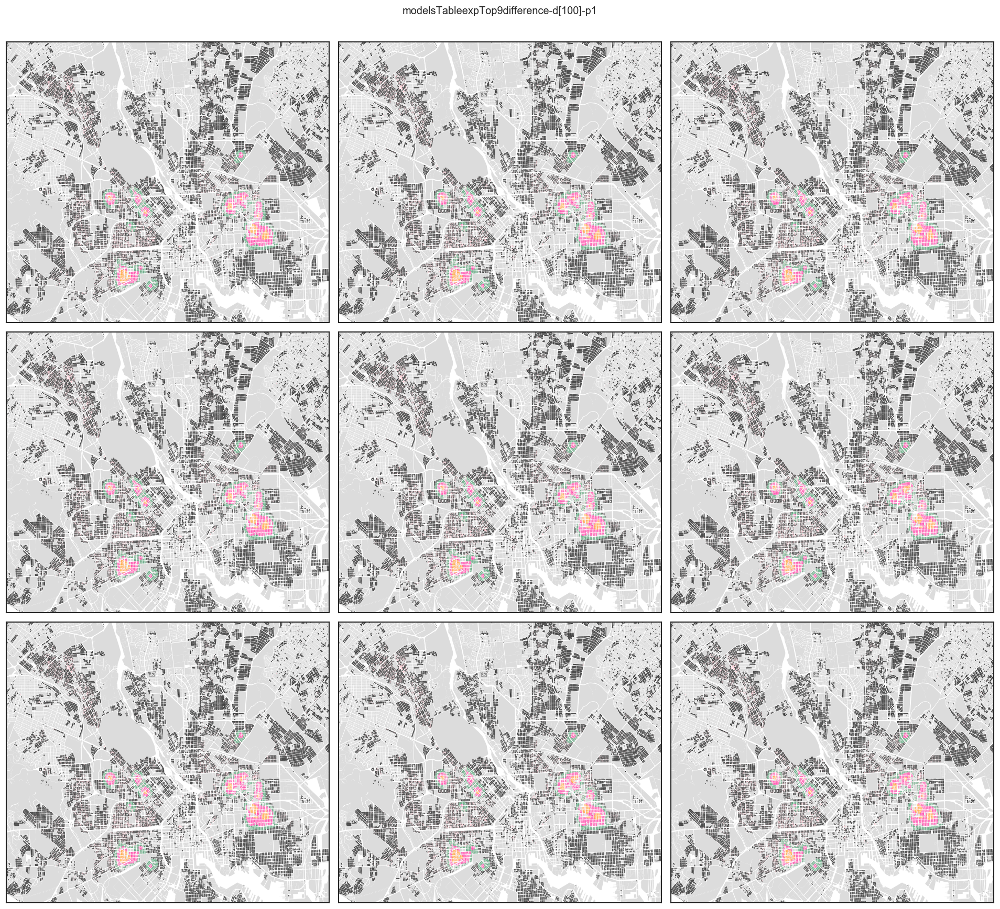

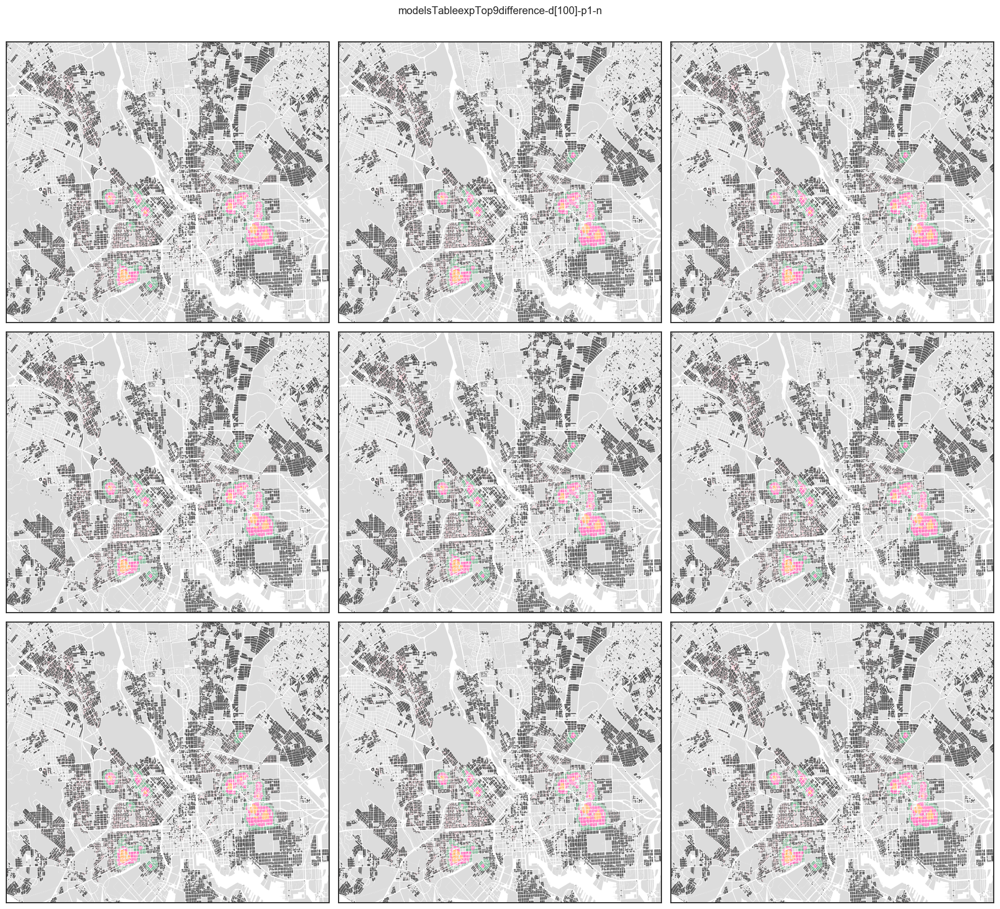

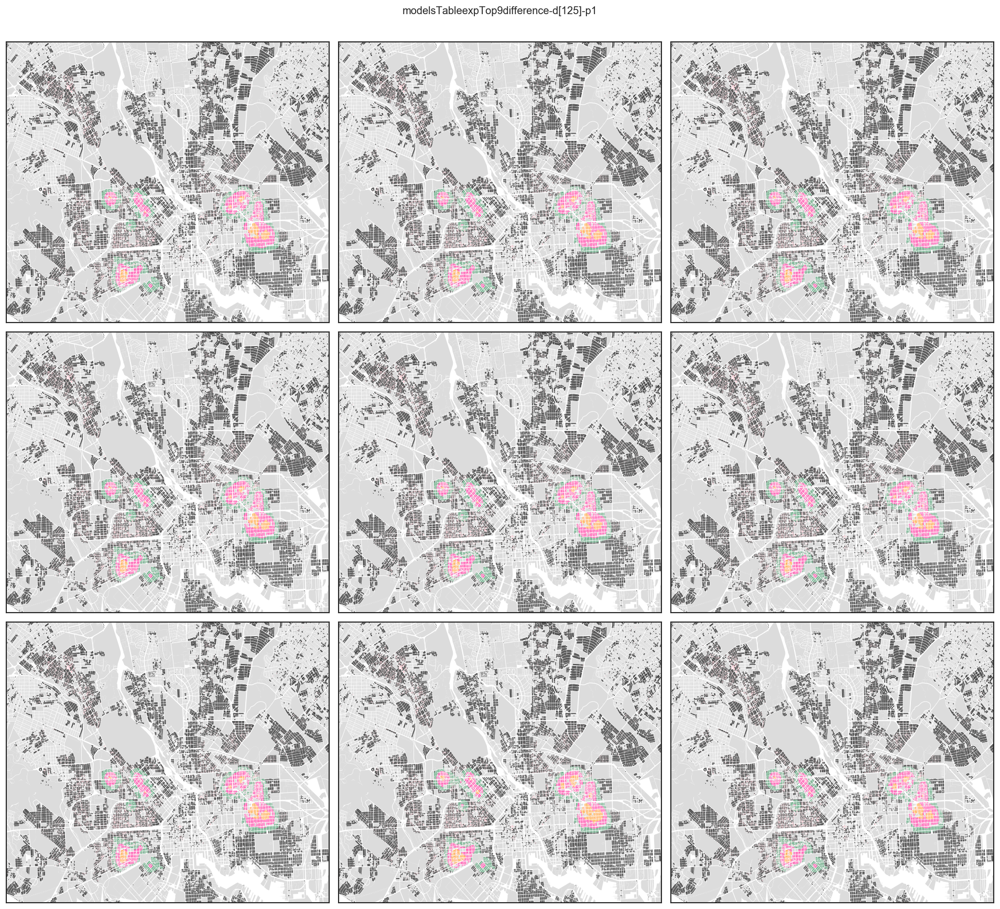

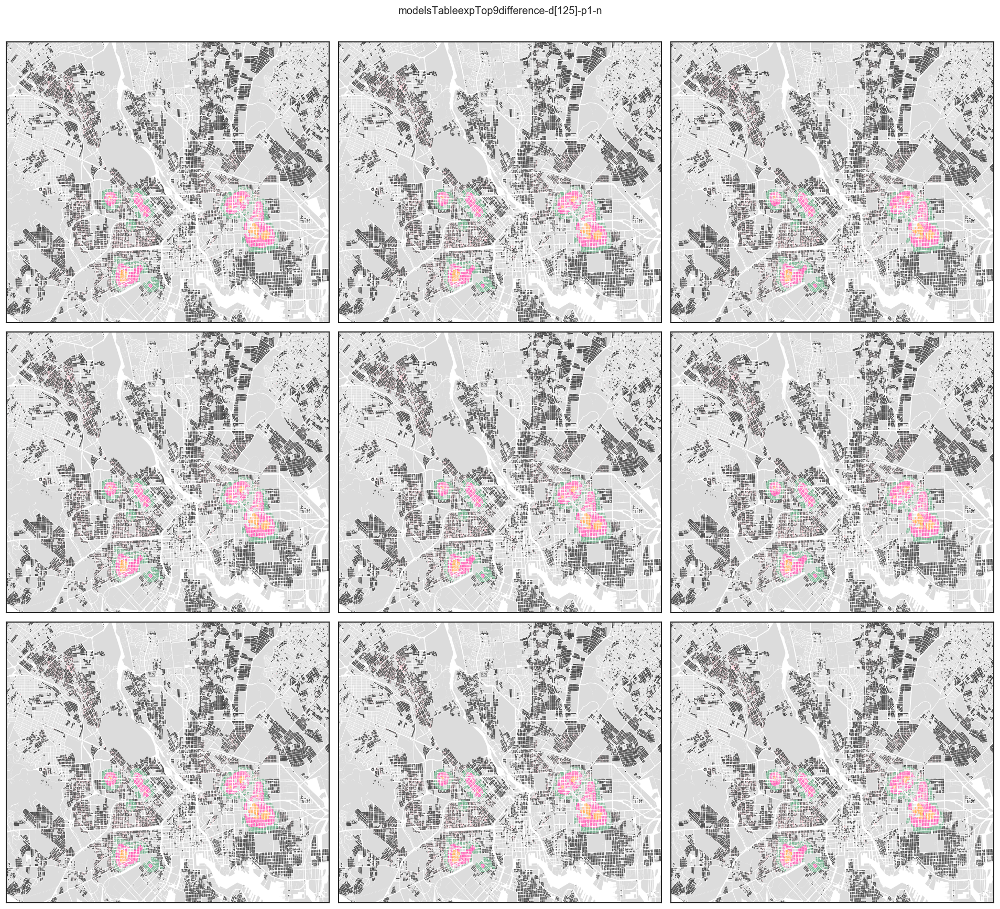

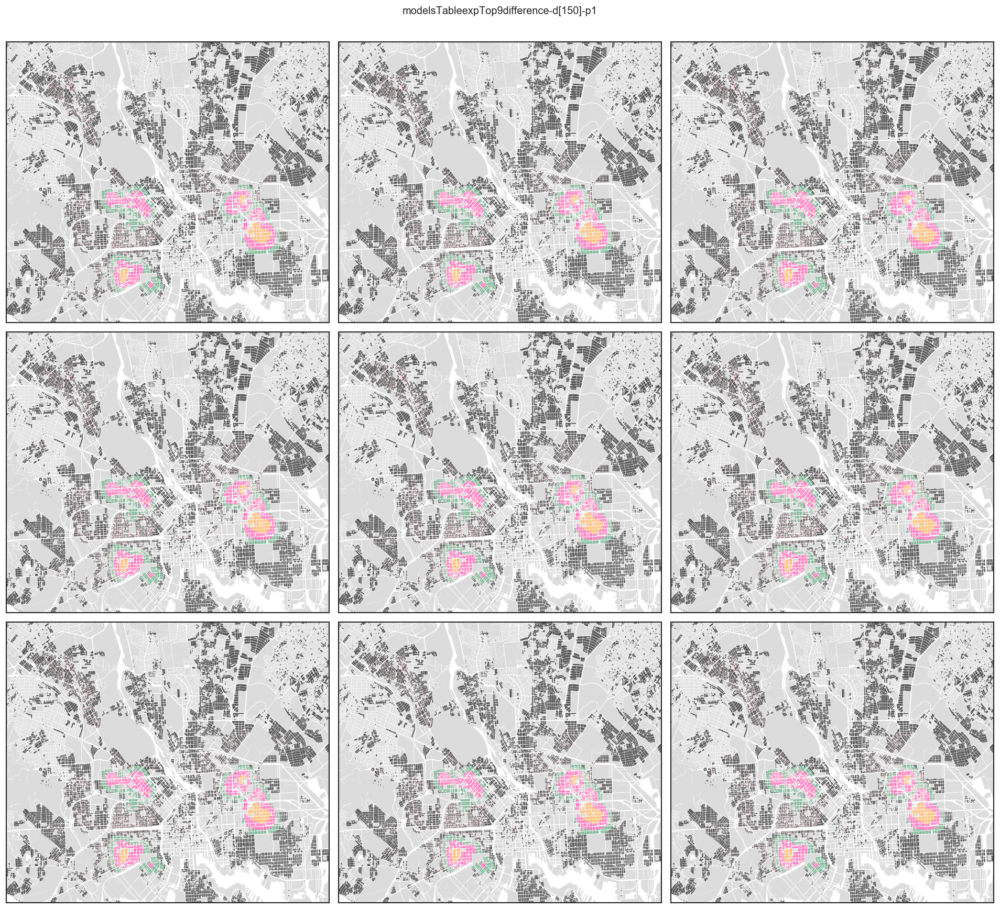

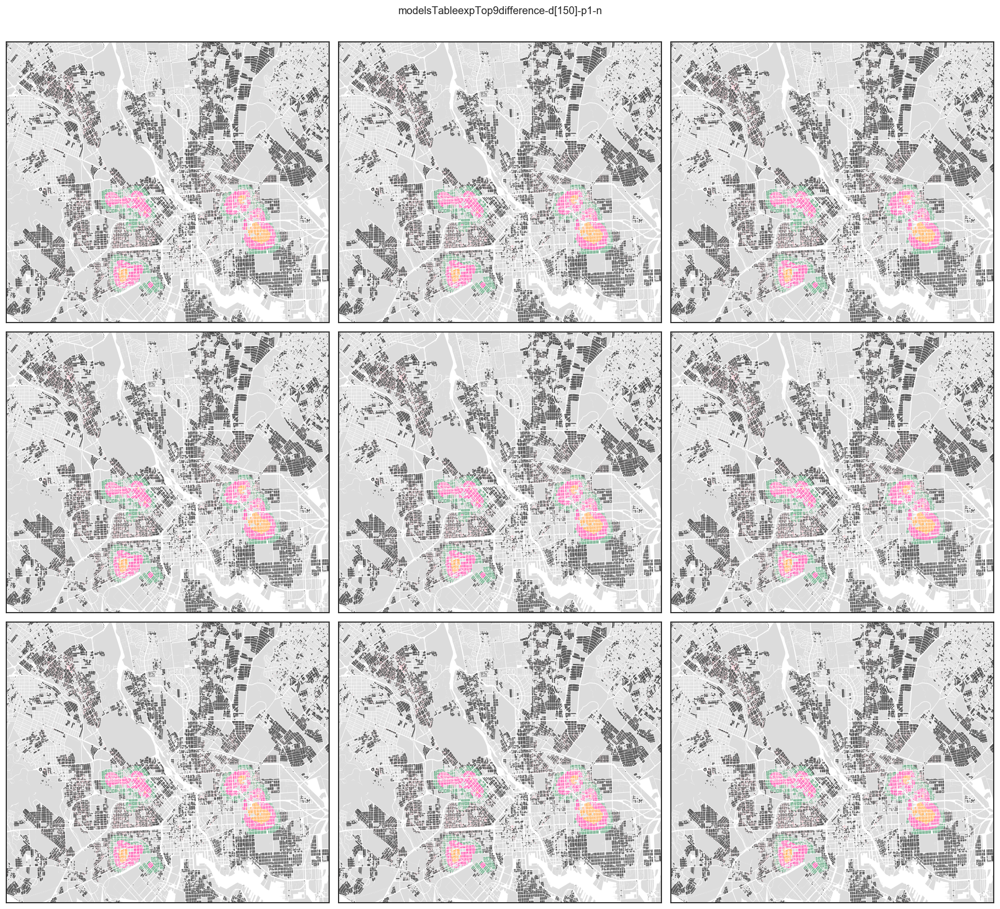

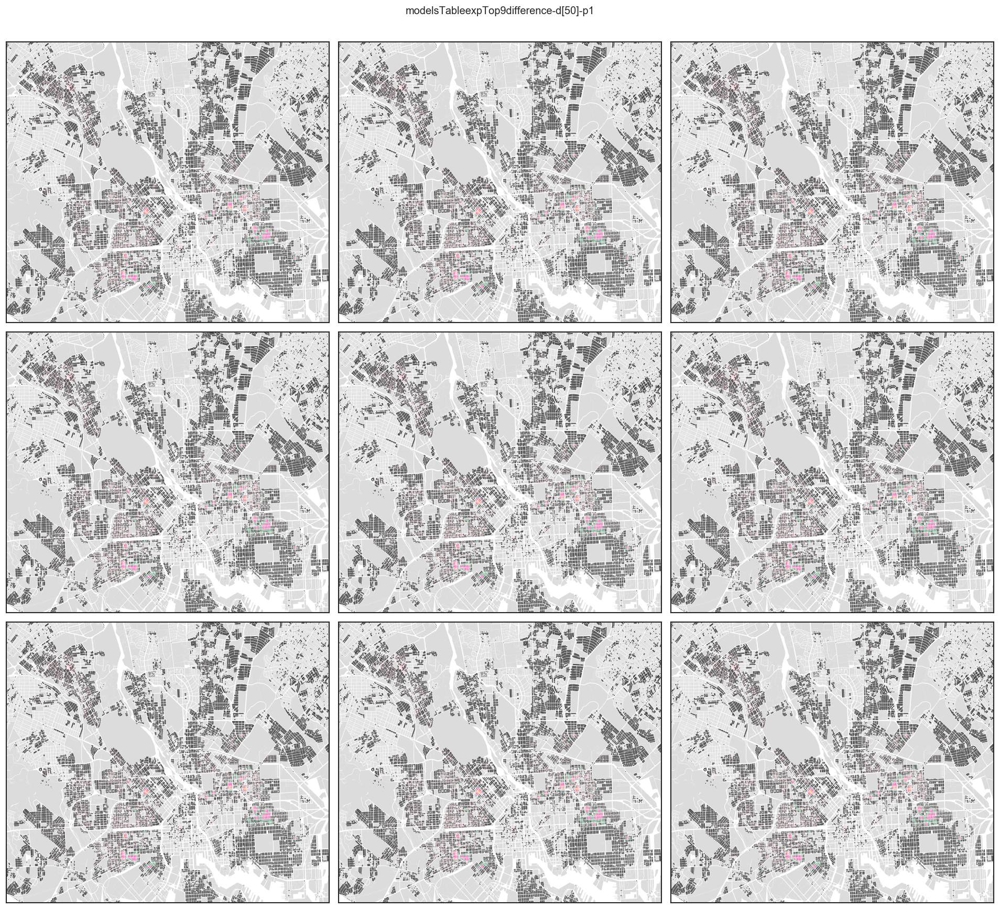

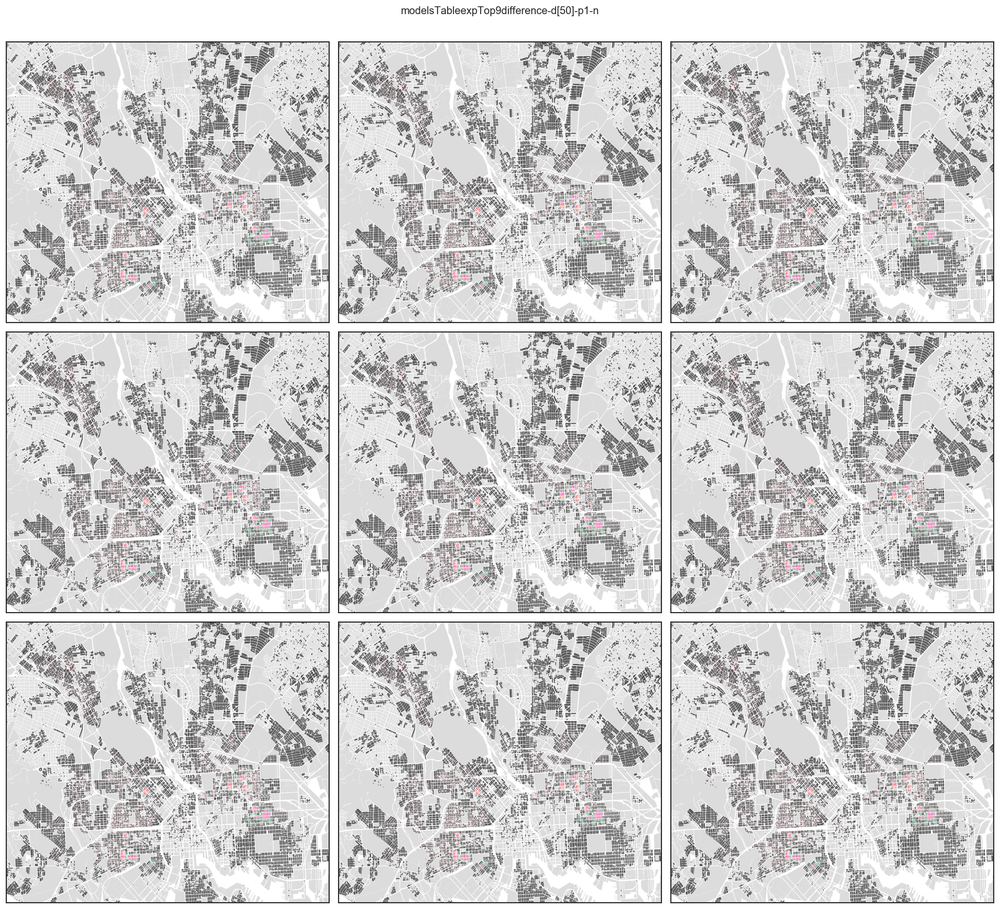

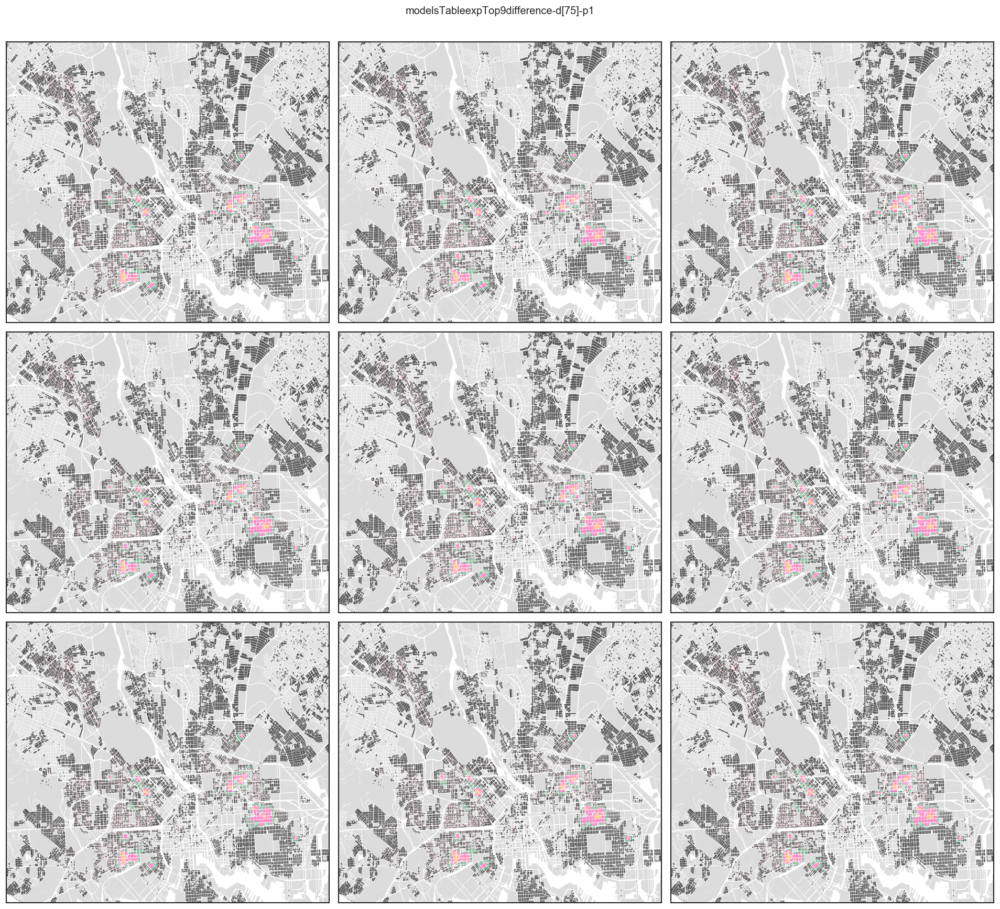

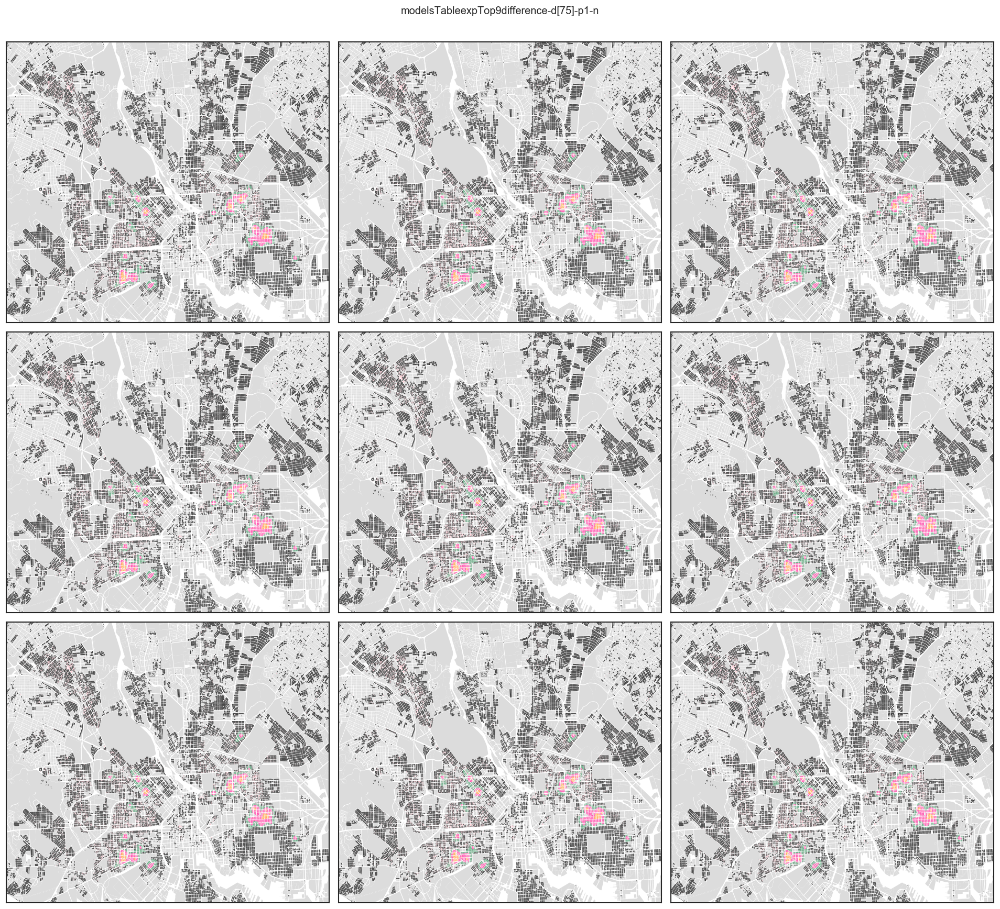

In [7]:
for file_ in files:
    model_house_df = pd.read_csv(file_,index_col=0)
    model_house_df = pd.DataFrame(np.array(model_house_df),
                                  columns=['model','iter','Cost','Num_of_houses','ObjVal','Time','budg'] + 
                                  list(gdf.ID) + ["power","distance"])
    
    det = file_.split("-")
    dis = det[1][2:-1]
    p = det[2][1:]
    objtype = "maxdif" if len(det) == 3 else "normal"

    fig ,axes = plt.subplots(nrows = 3,ncols=3,figsize=(16,14), dpi=120)

    for i in range(9):
        Area_plot("modelexp-d{}-p{}".format(dis,p) ,i+1, 5000000,ax = axes[i/3][i%3],coltype = 2,
                  modeltype = "exp",objtype=objtype)

        axes[i/3][i%3].set_yticklabels([])
        axes[i/3][i%3].set_xticklabels([])

    fig.suptitle(file_,y = 1.03)
    fig.tight_layout()
    
    fig.savefig('combineplot/{}.pdf'.format(file_),format='pdf', dpi=150,bbox_inches='tight')
    

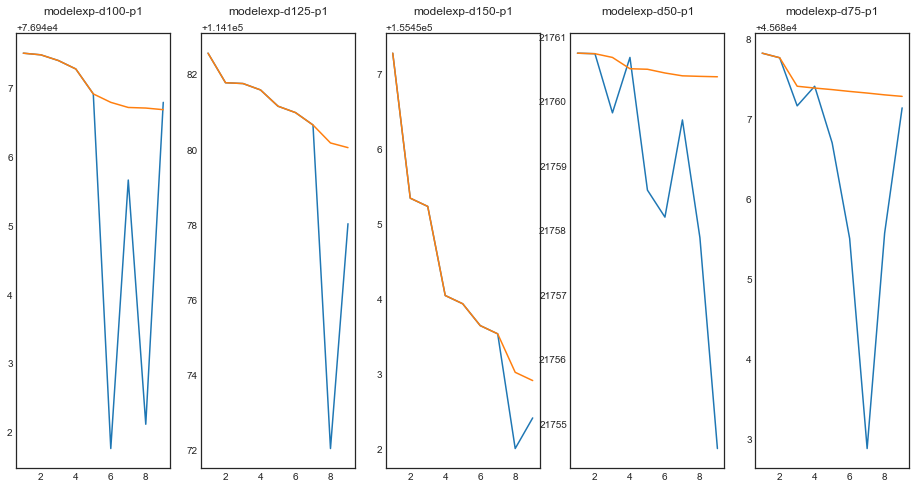

In [52]:
fig, axes = plt.subplots(ncols=5, figsize = (16,8))
count = 0
for model in sorted(improvementdict.model.unique()):
        axes[count].plot(range(1,10),improvementdict[(improvementdict.model == model) 
            & (improvementdict.obj == "maxdif")].ObjValForOccupied, label = "{}_maxdif".format(model))
        axes[count].plot(range(1,10),improvementdict[(improvementdict.model == model) 
            & (improvementdict.obj == "normal")].ObjValForOccupied, label = "{}_normal".format(model))
        axes[count].set_title(model,y = 1.03)
        count += 1
        

# compare the houses

In [63]:
housesdf = pd.DataFrame(index=range(1,10))

for file_ in files[::2]:    
    a = pd.read_csv(file_,index_col=0)
    b = pd.read_csv('{}-n'.format(file_),index_col=0)
    
    originindex = b[map(str,gdf.ID)].iloc[0][b[map(str,gdf.ID)].iloc[0] == 1].index
    housesdf[file_] = list(b.iloc[0].Num_of_houses - a[originindex].sum(axis = 1))

In [64]:
housesdf

,modelsTableexpTop9difference-d[100]-p1,modelsTableexpTop9difference-d[125]-p1,modelsTableexpTop9difference-d[150]-p1,modelsTableexpTop9difference-d[50]-p1,modelsTableexpTop9difference-d[75]-p1
1,0.0,0.0,0.0,0.0,0.0
2,2.0,2.0,1.0,2.0,1.0
3,2.0,1.0,1.0,7.0,4.0
4,2.0,1.0,1.0,2.0,2.0
5,1.0,1.0,1.0,10.0,4.0
6,14.0,1.0,1.0,8.0,6.0
7,5.0,1.0,1.0,7.0,12.0
8,11.0,14.0,3.0,8.0,5.0
9,1.0,5.0,2.0,16.0,4.0


In [138]:
def top_block_plot( model, iter_, obj,t = 500):
    
    ogdf_copy = ogdf.copy()
    id_sum = list(improvementdict[(improvementdict.model == model) &
                                  (improvementdict.iter == iter_) &
                                  (improvementdict.obj == obj)][ogdf.ID].iloc[0])
    

    ogdf_copy["id_sum"] = id_sum
    
    top = ogdf_copy.groupby("Block").id_sum.mean().sort_values(ascending = False)
    

    ogdf_copy["avg"] = ogdf_copy.Block.apply( lambda var: top[var])
    
    fig = plt.figure(2, figsize=(16,6.5), dpi=120)
    ax2 = fig.add_subplot(121)
    ax2.bar(range(t),top.values[:t])
    #ax2.set_xticks(range(t))
    #ax2.set_xticklabels(list(top.index),rotation='vertical');
    
    
    ax = fig.add_subplot(122)
    
    ax.set_xlim(-76.7,-76.55)
    ax.set_ylim(39.270,39.36)
    background.plot(ax = ax, color = "gainsboro")
    
    
    #ogdf_copy.plot(ax = ax, column = "avg")
    
    #ogdf.plot(ax= ax,color = "black")  # "seagreen","deeppink","darkorange"
    ogdf_copy[ogdf_copy.Block.apply(lambda var: var in set(top[top>7].index))].plot(ax = ax,color = "darkorange")
    ogdf_copy[ogdf_copy.Block.apply(lambda var: var in set(top[(top<=7) & (top>5)].index))].plot(ax = ax,color = "deeppink")
    ogdf_copy[ogdf_copy.Block.apply(lambda var: var in set(top[(top<=5) & (top>2.5)].index))].plot(ax = ax,color = "seagreen")
    ogdf_copy[ogdf_copy.Block.apply(lambda var: var in set(top[(top<=2.5) ].index))].plot(ax = ax,color = "black")
    #ogdf_copy[ogdf_copy.Block.apply(lambda var: var in set(top[(top<=4) & (top>2)].index))].plot(ax = ax,color = "seagreen")
    return 

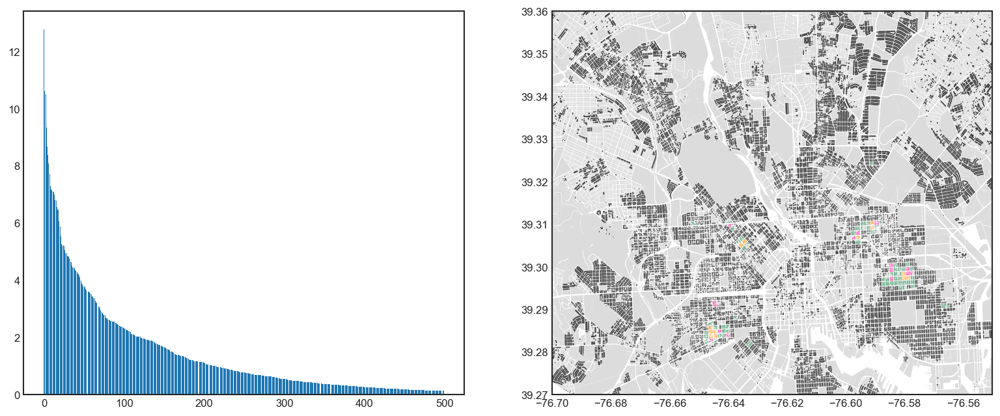

In [139]:
top_block_plot(model = "modelexp-d75-p1", iter_ = 7, obj = "maxdif")

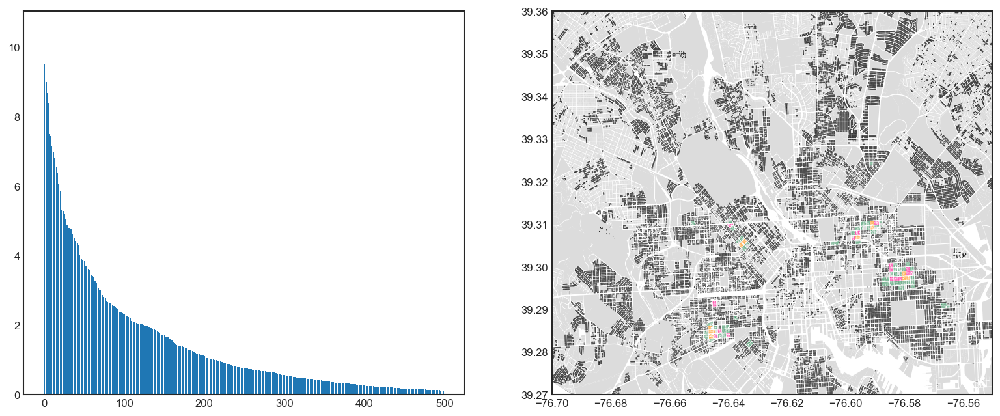

In [140]:
top_block_plot(model = "modelexp-d75-p1", iter_ = 1, obj = "normal")

In [141]:
improvementdict.to_csv('combineplot/expmaxdifference/improvementdict')

In [149]:
model_house  = pd.read_csv('modelsTable')

In [151]:
files

['modelsTableexpTop9difference-d[100]-p1',
 'modelsTableexpTop9difference-d[100]-p1-n',
 'modelsTableexpTop9difference-d[125]-p1',
 'modelsTableexpTop9difference-d[125]-p1-n',
 'modelsTableexpTop9difference-d[150]-p1',
 'modelsTableexpTop9difference-d[150]-p1-n',
 'modelsTableexpTop9difference-d[50]-p1',
 'modelsTableexpTop9difference-d[50]-p1-n',
 'modelsTableexpTop9difference-d[75]-p1',
 'modelsTableexpTop9difference-d[75]-p1-n']